# Session settings

## wandb logging

In [1]:
%pip install wandb -q


[notice] A new release of pip is available: 23.0.1 -> 24.1.2
[notice] To update, run: python3 -m pip install --upgrade pip


In [2]:
import wandb
# for this project - a3b918f2e6787138e30babed20cd74dc7143f1az
wandb.login(key="a3b918f2e6787138e30babed20cd74dc7143f1a9")

wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /home/jupyter/.netrc


True

## imports

In [3]:
import os
import wandb
import pickle
import random
from glob import glob
from tqdm.notebook import tqdm

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score

import torch
import torch.nn as nn
import torch.nn.functional as F

import torch_geometric.transforms as T
from torch_geometric.nn import GraphSAGE
from torch_geometric.utils import to_networkx
from torch_geometric.loader import LinkNeighborLoader

from catboost import CatBoostRegressor, Pool

from sklearn.manifold import TSNE
from umap import UMAP

import sys

sys.path.append("../../src")

from utils import EarlyStoppingR2, EarlyStoppingContrastiveLoss, set_seed

# Loading graph data

In [38]:
# loading graph data
regions_mapper = {
    777 : "Moscow",
    812 : "Saint-Petersburg",
    287 : "Kazan",
    473 : "Sochi"
}

# Target region
region = 777

dataset = torch.load(
    f"/home/jupyter/datasphere/project/repo/geo_embeddings/data/preprocessed_graphs/{regions_mapper[region]}/graph.pickle"
)

apply_feature_propagation = True # apply features propagation or not (recommended - True) 

if apply_feature_propagation:s
    dataset.x[dataset.x == -1] = torch.nan
    transform = T.FeaturePropagation(missing_mask=torch.isnan(dataset.x), num_iterations = 400)
    dataset = transform(dataset)

In [39]:
class cfg:
    def __init__(self, ):
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.seed = 111
        self.graph_num_nodes = dataset.x.shape[0]
        
cfg = cfg()

set_seed(cfg.seed)

dataset = dataset.to(cfg.device, "x", "edge_index")

# EarlyStopping

# Train

In [4]:
def train_one_epoch_GraphSage(loader, model, optimizer, reduction="mean"):
    
    model.train()
    
    total_loss = 0.0
        
    for i, batch in enumerate(loader):
        
        batch = batch.to(cfg.device)
        h = model(batch.x, batch.edge_index)
        
        h_src = h[batch.edge_label_index[0]]
        h_dst = h[batch.edge_label_index[1]]
        pred = (h_src * h_dst).sum(dim=-1)
        loss = F.binary_cross_entropy_with_logits(pred, batch.edge_label)
        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        total_loss += loss.item() * pred.size(0)
        
    return total_loss / cfg.graph_num_nodes

def eval_one_epoch_catboost(model, dataset, return_hidden=False):
    
    model.eval()
    
    with torch.no_grad():
        out = model(dataset.x, dataset.edge_index).cpu()
    
    all_folds_val_r2 = []
    
    for fold in range(5):

        clf = CatBoostRegressor(
            iterations=500,
            task_type="GPU",
            border_count=254,
            random_state=cfg.seed,
            eval_metric="RMSE",
            use_best_model=True
        )

        train_pool = Pool(data=out[getattr(dataset, f"train_fold_{fold}")].numpy(), label=dataset.y[getattr(dataset, f"train_fold_{fold}")].numpy())
        eval_pool = Pool(data=out[getattr(dataset, f"val_fold_{fold}")].numpy(), label=dataset.y[getattr(dataset, f"val_fold_{fold}")].numpy())

        clf.fit(
            train_pool, 
            verbose=0,
            eval_set=[eval_pool],
        )
        
        val_preds = clf.predict(eval_pool)
        
        val_score = r2_score(eval_pool.get_label(), val_preds.reshape(-1))
        
        all_folds_val_r2.append(val_score)
        
    all_folds_val_r2 = np.mean(all_folds_val_r2)

    if return_hidden: 
        return all_folds_val_r2, out
    else: 
        return all_folds_val_r2
    
    
def plot_embeddings(train_dataset=None, out=None, epoch=None):

    mapper_umap = UMAP(n_components=2, metric="cosine", n_neighbors=15, min_dist=0.1, random_state=cfg.seed)

    mapped_2d_umap = mapper_umap.fit_transform(out.cpu())
    
    f, axs = plt.subplots(2, 2, figsize=(20, 16))

    axs = list(axs[0]) + list(axs[1])
    out[out <= 0] = 1

    #1
    # plotting target dist with train
    sns.scatterplot(
        x = mapped_2d_umap[train_dataset.y.cpu() == -1][:, 0],
        y = mapped_2d_umap[train_dataset.y.cpu() == -1][:, 1],
        hue=train_dataset.y.cpu()[train_dataset.y.cpu() == -1],
        palette={-1:'gray'},
        ax=axs[0],
    );
    sns.scatterplot(
        x = mapped_2d_umap[:, 0][train_dataset.train_mask.cpu()],
        y = mapped_2d_umap[:, 1][train_dataset.train_mask.cpu()],
        palette = 'winter_r',
        hue=np.log10(train_dataset.y.cpu()[train_dataset.train_mask.cpu()]),
        ax=axs[0],
    );



    #2
    # plotting target dist with val

    sns.scatterplot(
        x = mapped_2d_umap[train_dataset.y.cpu() == -1][:, 0],
        y = mapped_2d_umap[train_dataset.y.cpu() == -1][:, 1],
        hue=train_dataset.y.cpu()[train_dataset.y.cpu() == -1],
        palette={-1:'gray'},
        ax=axs[2],
    );
    sns.scatterplot(
        x = mapped_2d_umap[train_dataset.val_mask.cpu()][:, 0],
        y = mapped_2d_umap[train_dataset.val_mask.cpu()][:, 1],
        palette = 'winter_r',
        hue=np.log10(train_dataset.y.cpu()[train_dataset.val_mask.cpu()]),
        ax=axs[2],
    );



    #3
    # plotting pib3 dist with train
    sns.scatterplot(
        x = mapped_2d_umap[:, 0],
        y = mapped_2d_umap[:, 1],
        palette = 'winter_r',
        hue=np.log10(train_dataset.x[:, 97].cpu() + 1),
        ax=axs[1],
    );





    #4
    # plotting pib3 dist with val
    sns.scatterplot(
        x = mapped_2d_umap[:, 0],
        y = mapped_2d_umap[:, 1],
        palette = 'winter_r',
        hue=np.log10(train_dataset.x[:, 97].cpu() + 1),
        ax=axs[3],
    );


    for ax in axs:
        ax.grid(False)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.get_legend().remove()

    axs[0].set_title("target")
    axs[1].set_title("pib3")


    f.tight_layout()
    
    f.figure.savefig(f'/home/jupyter/datasphere/project/notebooks/unsupervised/graph_sage/sage_checkpoints_sochi/embeddings_visual_{epoch}.jpeg', dpi=100)
    
    


def train_embedder(
    model=None, 
    loader=None, 
    optimizer=None, 
    train_cfg=None,
    full_dataset=None,
    earlystopper_loss=None,
    earlystopper_r2=None

):

    stream = tqdm(range(train_cfg.num_epochs))
    
    val_r2 = 0

    for epoch in stream:

        #training
        loss = train_one_epoch(         
            loader=loader,
            model=model,
            optimizer=optimizer, 
            reduction="mean"
        )
        
        if epoch % 25 == 0:
            
            val_r2, h = eval_one_epoch_catboost(
                model,
                full_dataset,
                return_hidden=True
            )
            
            plot_embeddings(
                train_dataset=full_dataset,
                out=h,
                epoch=epoch
            )

        stream.set_description(f"train loss: {round(loss, 5)}, val r2: {val_r2}")

        #saving model if its best till now
        earlystopper_loss(loss, model) 
        earlystopper_r2(val_r2, model)
        
        wandb.log(
            {
                "loss" : round(loss, 5), 
                "val_r2" : round(val_r2, 3)
            }
        )


# GraphSage model

In [5]:
set_seed(cfg.seed)


# GraphSage Pro Implementation
class GraphSagePro(nn.Module):


    def __init__(
        self,
        n_in=128,
        n_out=1,
        hidden_dim=128,
        n_layers=3
    ):

        super(GraphSagePro, self).__init__()

        self.encoder = nn.Sequential(
            nn.Linear(n_in, hidden_dim),
            nn.ReLU(),
            nn.LayerNorm(hidden_dim),
            nn.Linear(hidden_dim, hidden_dim),
        )
        
        self.conv = GraphSAGE(in_channels=hidden_dim, hidden_channels=hidden_dim * 4, out_channels=hidden_dim * 2, num_layers=n_layers)

        self.decoder = nn.Sequential(
            nn.Linear(hidden_dim * 2, hidden_dim),
            nn.LeakyReLU(negative_slope=0.1),
            # nn.Dropout(p=0.01),
            nn.Linear(hidden_dim, n_out),
        )

    def forward(self, x, edge_index):

        x = self.encoder(x)

        x = self.conv(x, edge_index)

        return self.decoder(x)

    def reset_parameters(self):
        for conv in self.convs:
            conv.reset_parameters()
        for skip in self.skips:
            skip.reset_parameters()

# Training setting

In [15]:
set_seed(cfg.seed)
#inductive setting
train_loader = LinkNeighborLoader(
    dataset,
    batch_size=128,
    shuffle=True,
    neg_sampling_ratio=1.0,
    num_neighbors=[-1, -1, -1, -1],
)

model = GraphSagePro(
    n_in=dataset.num_features,
    n_out=128,
    hidden_dim=128,
    n_layers=4
).to(cfg.device)

earlystopper_loss = EarlyStoppingContrastiveLoss(
    patience=1000,
    verbose=False,
    delta=0.00001,
    path="/home/jupyter/datasphere/project/notebooks/unsupervised/graph_sage/sage_checkpoints_sochi/best_model_loss.pt",
    trace_func=print,
)

earlystopper_r2 = EarlyStoppingR2(
    patience=1000,
    verbose=False,
    delta=0.01,
    path="/home/jupyter/datasphere/project/notebooks/unsupervised/graph_sage/sage_checkpoints_sochi/best_model_r2.pt",
    trace_func=print,
)

optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4, weight_decay=0)

class train_cfg:
    def __init__(self):
        self.num_epochs = 1000
        
if use_wandb := True:
    
    wandb.finish()

    wandb.init(
        # set the wandb project where this run will be logged
        project="GraphSage-embedder-other-cities-new",

        # track hyperparameters and run metadata
        config={
            "learning_rate": 1e-4,
            "architecture": "GraphSage",
            "dataset": "full",
            "epochs": 1000,
            "out_dim" : 128,
            "earlystopper" : "yes"
        }
    )

wandb:                                                                                
wandb: 
wandb: Run history:
wandb:   loss █▅▅▄▄▃▃▂▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▂▂▁▁▁▁▂▁▁▁
wandb: val_r2 ▂▃▁▁▃▂▃▅▃▅▇▅▅▄▆▅▆▄▅▄▃▄▆▄▄▄▅▃▃▄▄▆▅▅▄▃█▂▄▇
wandb: 
wandb: Run summary:
wandb:   loss 3.16414
wandb: val_r2 0.419
wandb: 
wandb: 🚀 View run wandering-yogurt-1 at: https://wandb.ai/codiim/GraphSage-embedder-other-cities/runs/t2xhii5m
wandb: ⭐️ View project at: https://wandb.ai/codiim/GraphSage-embedder-other-cities
wandb: Synced 5 W&B file(s), 0 media file(s), 0 artifact file(s) and 0 other file(s)
wandb: Find logs at: ./wandb/run-20240718_120208-t2xhii5m/logs
wandb: WARNING The new W&B backend becomes opt-out in version 0.18.0; try it out with `wandb.require("core")`! See https://wandb.me/wandb-core for more information.
wandb: Tracking run with wandb version 0.17.4
wandb: Run data is saved locally in /home/jupyter/work/resources/notebooks/unsupervised/graph_sage/wandb/run-20240718_133303-an25jv7h
wandb: Run

# Training embedder

  0%|          | 0/1000 [00:00<?, ?it/s]

/home/jupyter/.local/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/jupyter/.local/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/jupyter/.local/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/jupyter/.local/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  wa

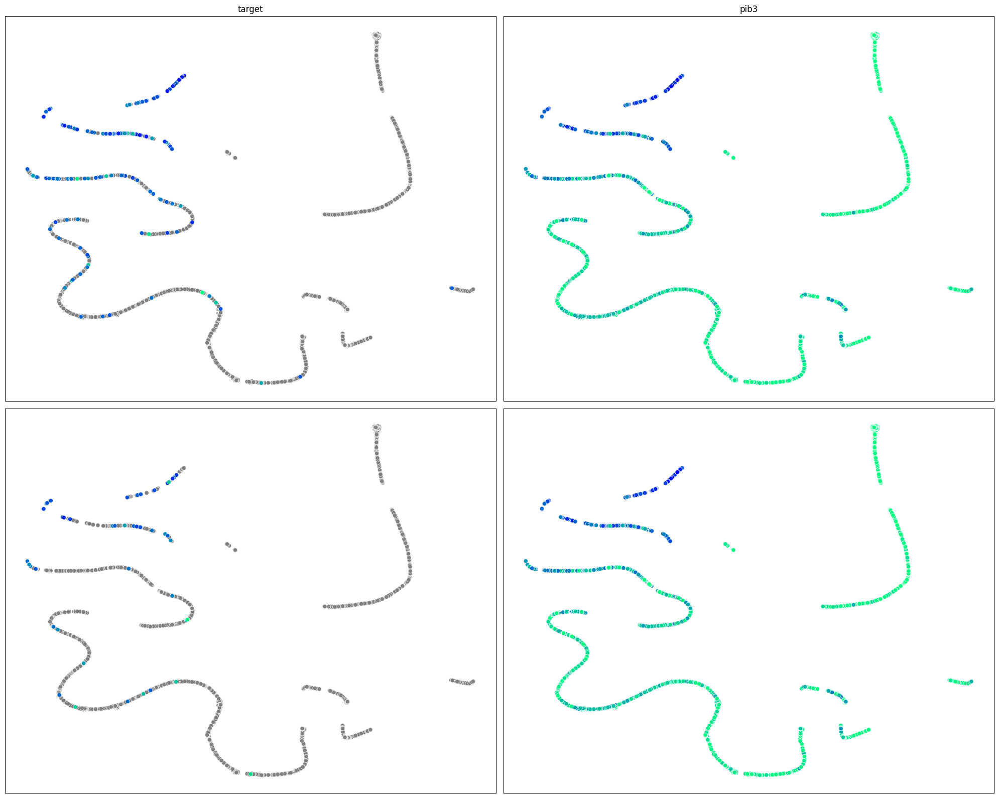

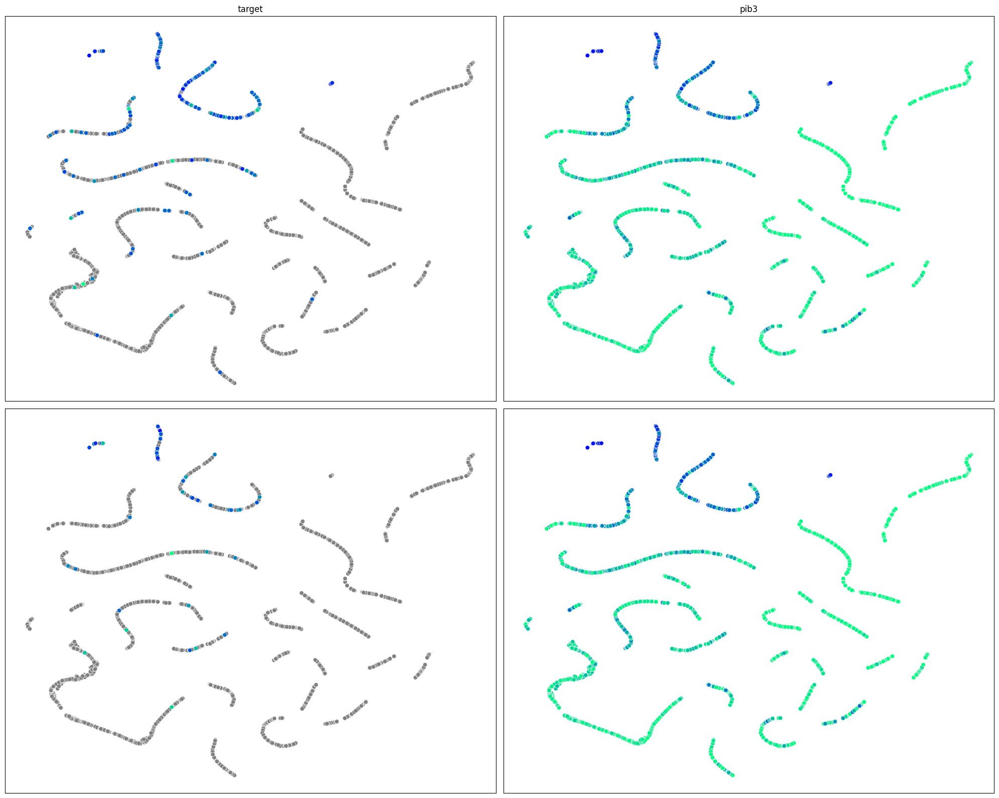

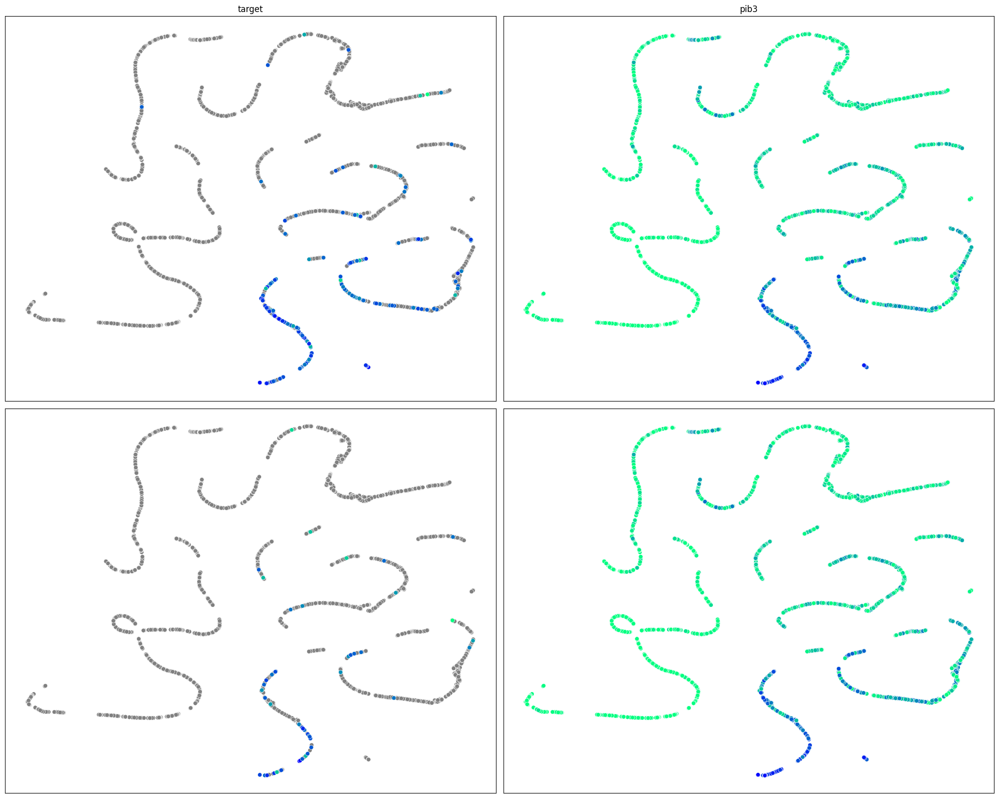

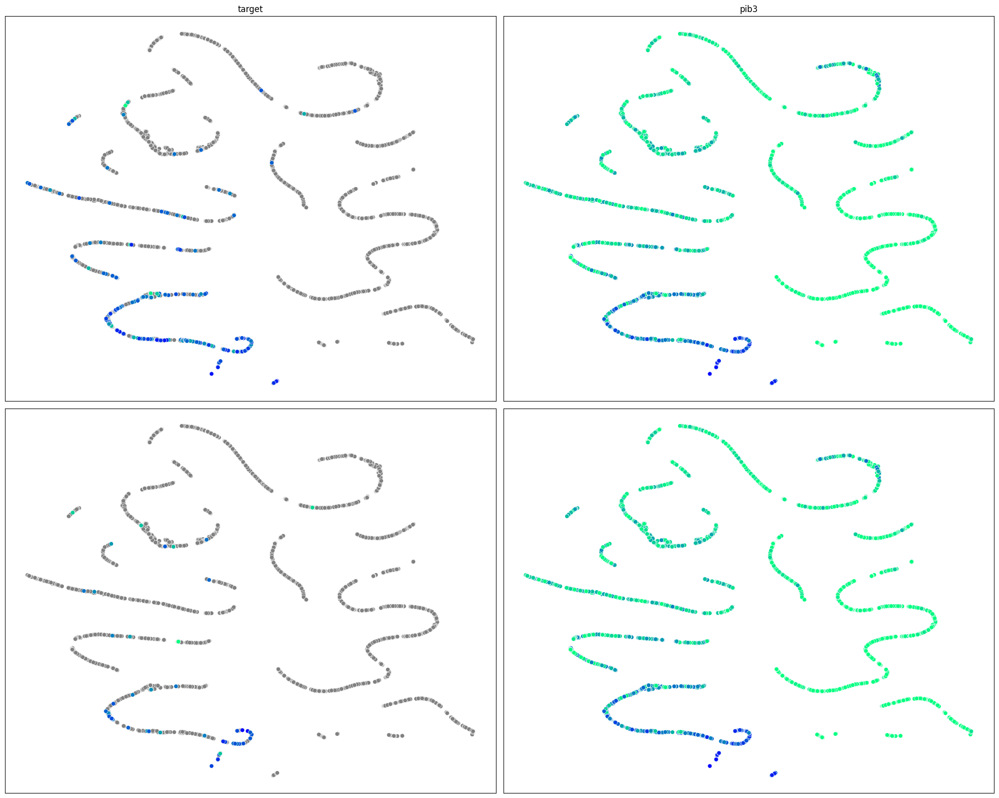

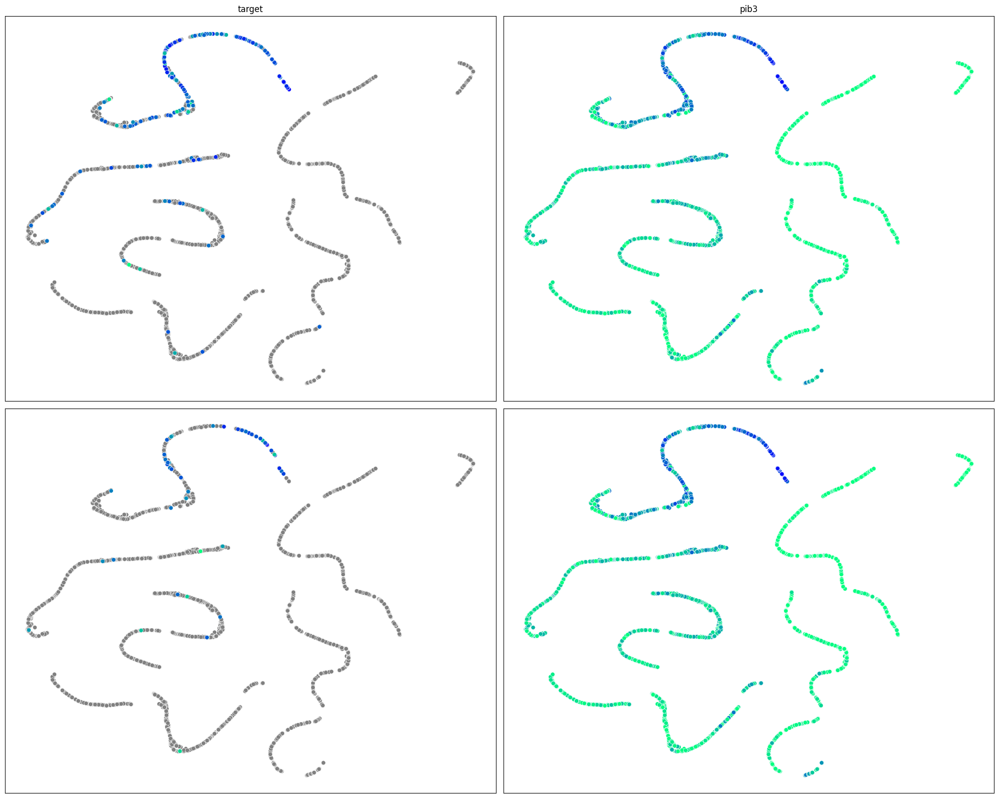

...

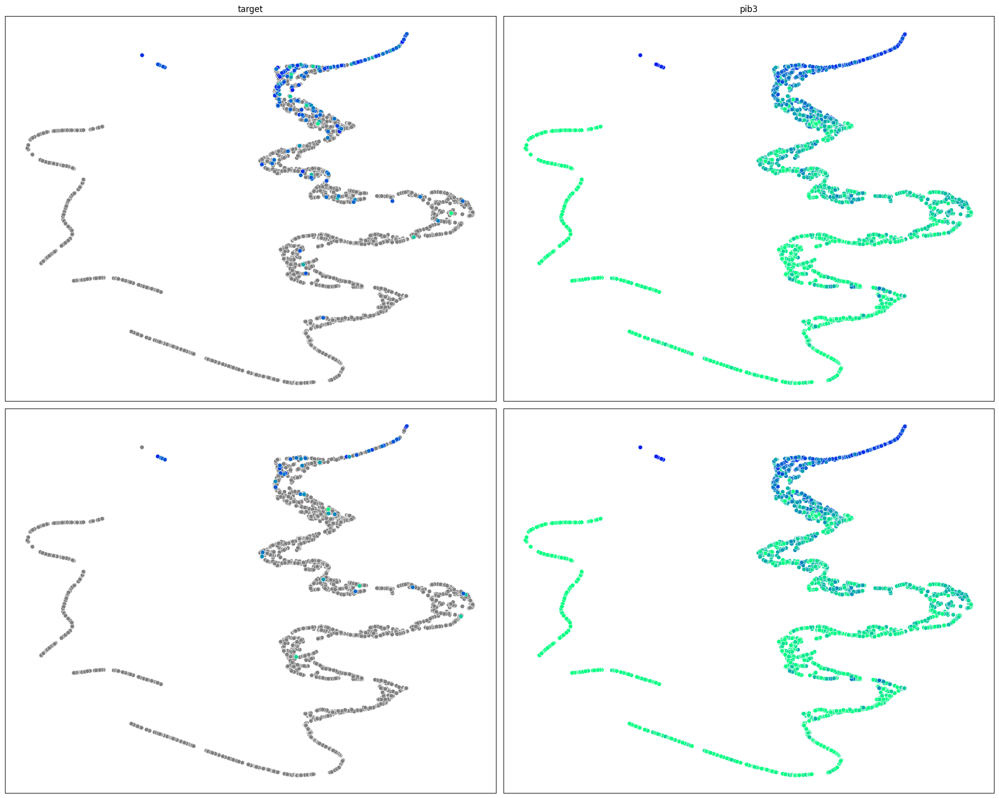

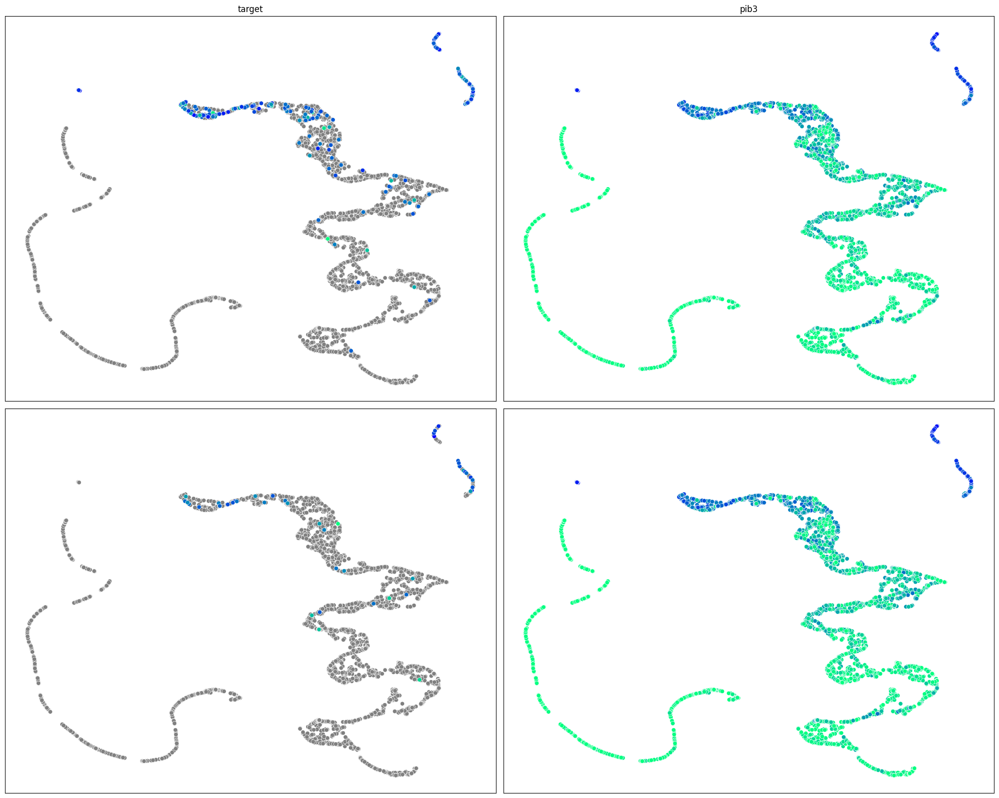

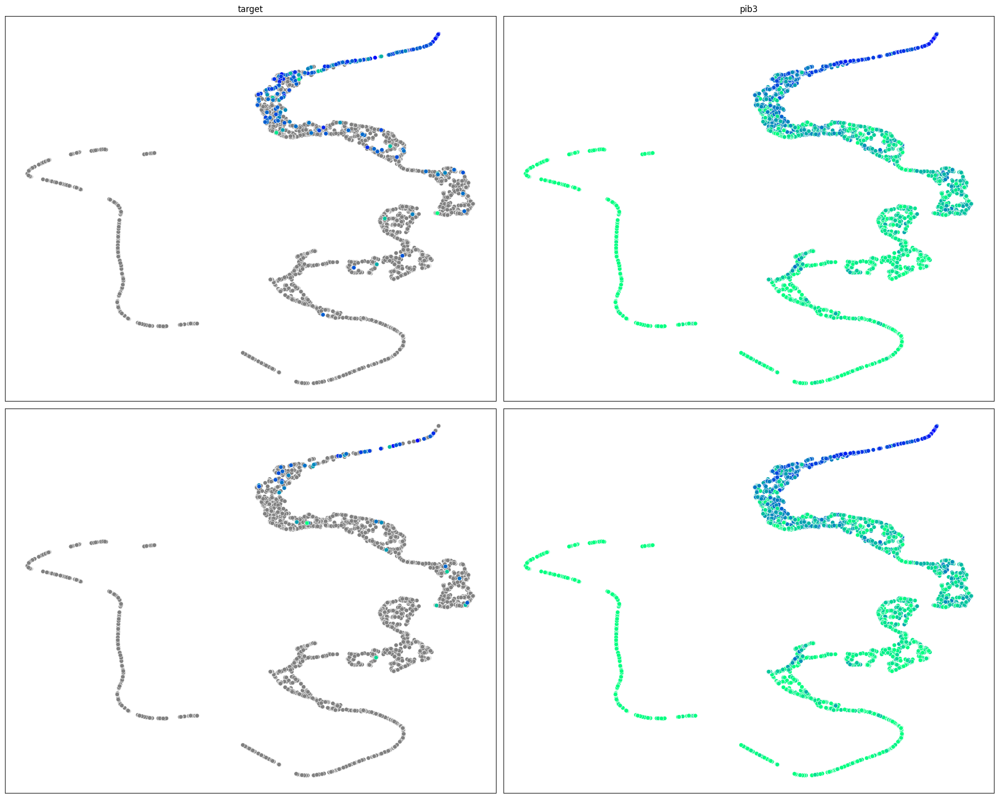

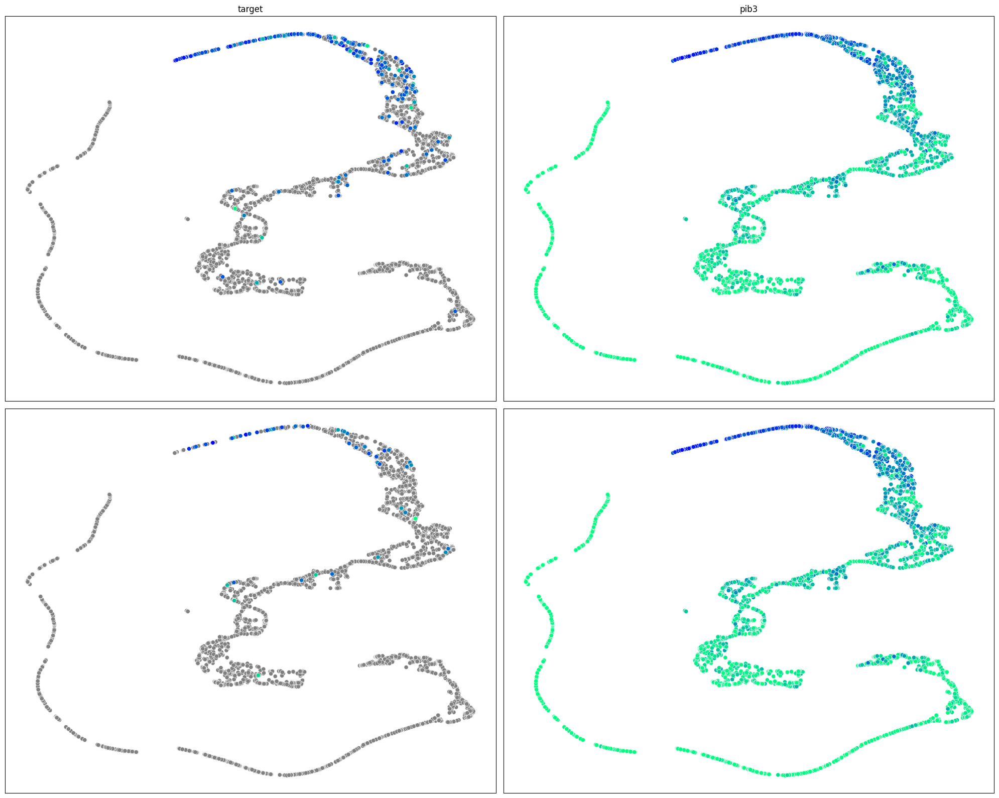

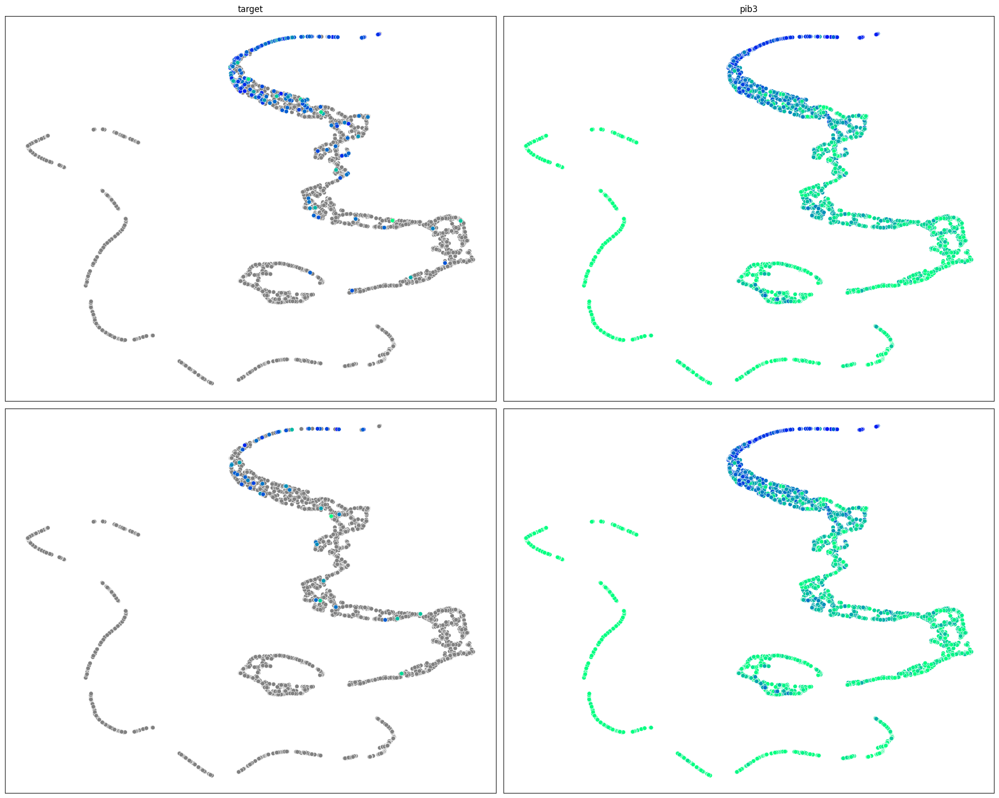

In [ ]:
train_embedder(
    model=model, 
    loader=train_loader, 
    optimizer=optimizer, 
    train_cfg=train_cfg(),
    full_dataset=dataset,
    earlystopper_loss=earlystopper_loss,ы
    earlystopper_r2=earlystopper_r2
)

# Evaluating using best model embeddings

In [46]:
def inference_one_epoch_catboost(model, dataset, add_features=True, return_hidden=False):
    
    model.eval()
    
    with torch.no_grad():
        out = model(dataset.x, dataset.edge_index)
    
    all_folds_val_r2 = []
    
    for fold in range(5):

        clf = CatBoostRegressor(
            iterations=500,
            task_type="CPU",
            border_count=254,
            random_state=cfg.seed,
            eval_metric="RMSE",
            use_best_model=True
        )
        
        train_x = out[getattr(dataset, f"train_fold_{fold}")]
        val_x = out[getattr(dataset, f"val_fold_{fold}")]
        
        if add_features:
            train_features = dataset.x[getattr(dataset, f"train_fold_{fold}")]
            val_features = dataset.x[getattr(dataset, f"val_fold_{fold}")]
            train_x = torch.cat([train_x, train_features], dim=-1)
            val_x = torch.cat([val_x, val_features], dim=-1)
            
#         print(train_x.shape, val_x.shape)
            

        train_pool = Pool(data=train_x.cpu().numpy(), label=dataset.y[getattr(dataset, f"train_fold_{fold}")].numpy())
        eval_pool = Pool(data=val_x.cpu().numpy(), label=dataset.y[getattr(dataset, f"val_fold_{fold}")].numpy())

        clf.fit(
            train_pool, 
            verbose=50,
            eval_set=[eval_pool],
        )
        
        val_preds = clf.predict(eval_pool)
        
        val_score = r2_score(eval_pool.get_label(), val_preds.reshape(-1))
        
        all_folds_val_r2.append(val_score)
        
    all_folds_val_r2 = np.mean(all_folds_val_r2)

    if return_hidden: 
        return all_folds_val_r2, out
    else: 
        return all_folds_val_r2

In [49]:
#evaluation

#Loading best model

best_model = model = GraphSagePro(
    n_in=dataset.num_features,
    n_out=128,
    hidden_dim=128,
    n_layers=4
).to(cfg.device)

best_model.load_state_dict(
    torch.load("/home/jupyter/datasphere/project/notebooks/unsupervised/graph_sage/sage_checkpoints/best_model_loss.pt", map_location="cpu")
)

<All keys matched successfully>

In [50]:
val_r2, embeds = inference_one_epoch_catboost(
    model=best_model, 
    dataset=dataset,
    add_features=True,
    return_hidden=True
)
print(f"mean per folds with features: val - {val_r2}")

# val_r2, embeds = inference_one_epoch_catboost(
#     model=best_model, 
#     dataset=dataset,
#     add_features=False,
#     return_hidden=True
# )
# print(f"mean per folds without features: val - {val_r2}")

Learning rate set to 0.087966
0:	learn: 24512161.4919307	test: 18379015.8940031	best: 18379015.8940031 (0)	total: 108ms	remaining: 54s
50:	learn: 11638478.9927793	test: 13702451.8950380	best: 13698268.9117557 (49)	total: 4.38s	remaining: 38.5s
100:	learn: 7221380.9197658	test: 12307913.5457259	best: 12307913.5457259 (100)	total: 8.47s	remaining: 33.5s
150:	learn: 4979035.8533013	test: 11955882.3300873	best: 11951371.7314779 (148)	total: 12.7s	remaining: 29.3s
200:	learn: 3800636.0484426	test: 11885808.0036590	best: 11885808.0036590 (200)	total: 17s	remaining: 25.3s
250:	learn: 3104605.7862637	test: 11883902.6978715	best: 11869629.2793927 (206)	total: 21.3s	remaining: 21.1s
300:	learn: 2564103.9446852	test: 11843111.2194155	best: 11843111.2194155 (300)	total: 25.6s	remaining: 16.9s
350:	learn: 2161550.9272039	test: 11818785.7104161	best: 11818785.7104161 (350)	total: 30s	remaining: 12.7s
400:	learn: 1860022.6163052	test: 11814619.6466335	best: 11811512.6706039 (383)	total: 34.4s	remaini

In [53]:
def plot_embeddings_return(train_dataset=None, out=None, epoch=None):
    
    #20 - good
    
    mapper_umap = UMAP(n_components=2, metric="cosine", n_neighbors=20, min_dist=0.1, random_state=cfg.seed)

    mapped_2d_umap = mapper_umap.fit_transform(out.cpu())
    
    f, axs = plt.subplots(2, 2, figsize=(20, 16))

    axs = list(axs[0]) + list(axs[1])
    out[out <= 0] = 1

    #1
    # plotting target dist with train
    sns.scatterplot(
        x = mapped_2d_umap[train_dataset.y.cpu() == -1][:, 0],
        y = mapped_2d_umap[train_dataset.y.cpu() == -1][:, 1],
        hue=train_dataset.y.cpu()[train_dataset.y.cpu() == -1],
        palette={-1:'gray'},
        ax=axs[0],
    );
    sns.scatterplot(
        x = mapped_2d_umap[:, 0][train_dataset.train_mask.cpu()],
        y = mapped_2d_umap[:, 1][train_dataset.train_mask.cpu()],
        palette = 'winter_r',
        hue=np.log10(train_dataset.y.cpu()[train_dataset.train_mask.cpu()]),
        ax=axs[0],
    );



    #2
    # plotting target dist with val

    sns.scatterplot(
        x = mapped_2d_umap[train_dataset.y.cpu() == -1][:, 0],
        y = mapped_2d_umap[train_dataset.y.cpu() == -1][:, 1],
        hue=train_dataset.y.cpu()[train_dataset.y.cpu() == -1],
        palette={-1:'gray'},
        ax=axs[2],
    );
    sns.scatterplot(
        x = mapped_2d_umap[train_dataset.val_mask.cpu()][:, 0],
        y = mapped_2d_umap[train_dataset.val_mask.cpu()][:, 1],
        palette = 'winter_r',
        hue=np.log10(train_dataset.y.cpu()[train_dataset.val_mask.cpu()]),
        ax=axs[2],
    );



    #3
    # plotting pib3 dist with train
    sns.scatterplot(
        x = mapped_2d_umap[:, 0],
        y = mapped_2d_umap[:, 1],
        palette = 'winter_r',
        hue=np.log10(train_dataset.x[:, 97].cpu() + 1),
        ax=axs[1],
    );





    #4
    # plotting pib3 dist with val
    sns.scatterplot(
        x = mapped_2d_umap[:, 0],
        y = mapped_2d_umap[:, 1],
        palette = 'winter_r',
        hue=np.log10(train_dataset.x[:, 97].cpu() + 1),
        ax=axs[3],
    );


    for ax in axs:
        ax.grid(False)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.get_legend().remove()

    axs[0].set_title("target") 
    axs[1].set_title("pib3")
    
    return mapped_2d_umap

/home/jupyter/.local/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


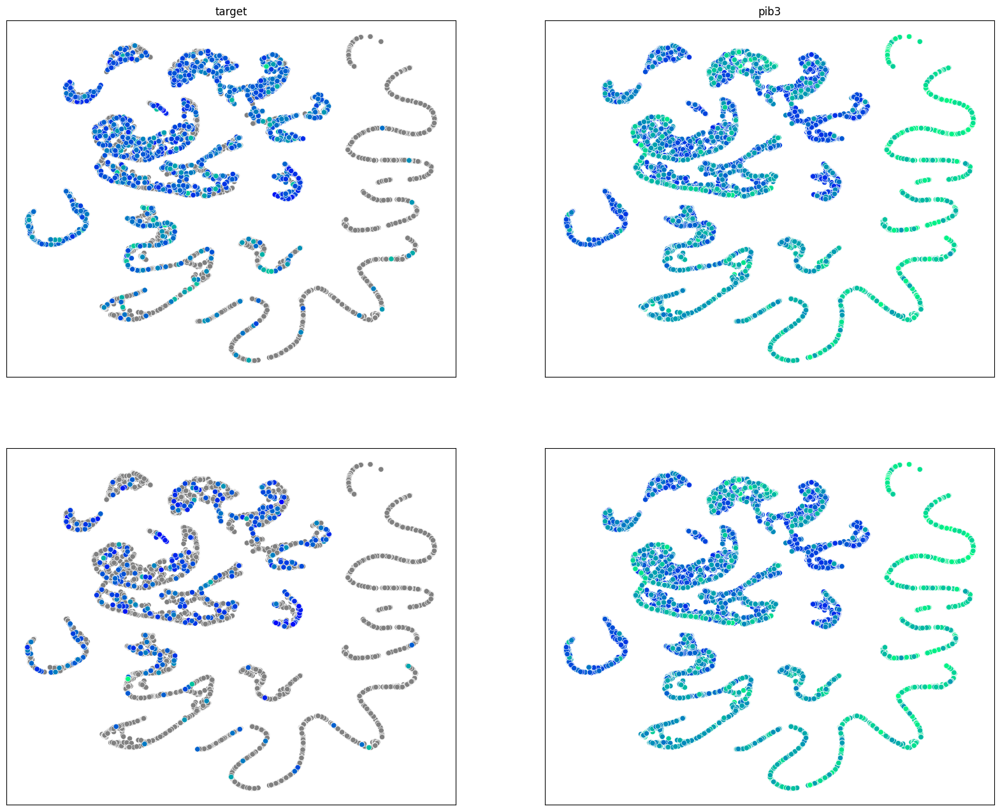

In [52]:
embeds_2d = plot_embeddings_return(train_dataset=dataset, out=embeds)

In [54]:
pib3_feature = dataset.x[:, 97]
mean_age_feature = dataset.x[:, 126]
geometry = dataset.geometry

In [55]:
import geopandas as gpd

In [56]:
emebeds_df = pd.DataFrame({
    "embeds_x" : embeds_2d[:, 0].flatten().tolist(),
    "embeds_y" : embeds_2d[:, 1].flatten().tolist(),
    "target" : dataset.y.tolist(),
    "pib3_feature" : pib3_feature.tolist(),
    "mean_age_feature" : mean_age_feature.tolist(),
    "geometry" : geometry,
    
})

embeds_gdf = gpd.GeoDataFrame(emebeds_df, geometry='geometry', crs='epsg:4326')

In [57]:
import pickle

In [58]:

embeds_gdf.to_pickle("./777_embeds.pickle")

In [ ]:
#  0.521 - сочи